# Mt. St. Helens

#### Hello Eric, 
#### Further to our conversation today about your project and snow cover on Mount St Helens, it would be very much appreciated if you can provide us with data for December 2019. We would like to validate the depth of snow cover on Mount St Helens for December 15 and 16, so if data for 1-16 December 2019 can be provided, it would be hugely appreciated. 

#### I copied my USF colleagues working on the project in this email. 

#### Many thanks, 
#### Niko

In [1]:
import numpy as np
import pandas as pd
import geopandas as gpd
from dask.distributed import Client
import py3dep
import geopandas as gpd
import rasterio as rio
import pystac
import pystac_client
import stackstac
import math
import shapely
import matplotlib.pyplot as plt
import os
import xarray as xr
from datetime import datetime
import ulmo
from datetime import datetime
import sys
import contextily as ctx
import rioxarray as rxr
from matplotlib_scalebar.scalebar import ScaleBar
import matplotlib
import matplotlib.transforms as mtransforms
import logging
sys.path.append('../sar_snowmelt_timing')
import s1_rtc_bs_utils

ModuleNotFoundError: No module named 'py3dep'

In [ ]:
#### CODE FOR DEVELOPMENT-- THIS RELOADS s1_rtc_bs_utils MODULE
sys.modules.pop('s1_rtc_bs_utils')
import s1_rtc_bs_utils

In [3]:
# GDAL environment variables for better performance
os.environ['AWS_REGION']='us-west-2'
os.environ['GDAL_DISABLE_READDIR_ON_OPEN']='EMPTY_DIR' 
os.environ['AWS_NO_SIGN_REQUEST']='YES' 
#
xr.set_options(keep_attrs=True)
# Paste /proxy/localhost:8787 for cluster diagnostics
client = Client(local_directory='/tmp', processes=False,silence_logs=logging.ERROR)
client

/mnt/working/egagli/sw/miniconda3/envs/aws-rtc-stac2/lib/python3.8/site-packages/distributed/node.py:160: UserWarning: Port 8787 is already in use.
Perhaps you already have a cluster running?
Hosting the HTTP server on port 46581 instead
  warnings.warn(


Connection method: Cluster object,Cluster type: distributed.LocalCluster
Dashboard: http://172.25.45.79:46581/status,
Dashboard: http://172.25.45.79:46581/status,Workers: 1
Total threads: 32,Total memory: 125.71 GiB
Status: running,Using processes: False
Comm: inproc://172.25.45.79/499803/1,Workers: 1
Dashboard: http://172.25.45.79:46581/status,Total threads: 32
Started: Just now,Total memory: 125.71 GiB
Comm: inproc://172.25.45.79/499803/4,Total threads: 32
Dashboard: http://172.25.45.79:40613/status,Memory: 125.71 GiB
Nanny: None,


In [4]:
# comment out
fontsize=19

font = {'family' : 'DejaVu Sans',
        'weight' : 'normal',
        'size'   : fontsize}

matplotlib.rc('font', **font)

In [5]:
name = 'Mt. St. Helens (46.19N)'
geojson = '../input/MSH_shapefiles/MSH.geojson'     
collection = '../input/sentinel1-rtc-aws/mycollection_helens.json'        

In [6]:
bbox_gdf = gpd.read_file(geojson)
ts_ds = s1_rtc_bs_utils.get_s1_rtc_stac(bbox_gdf,start_time='2019-01-01',end_time='2021-01-01',orbit_direction='all',polarization='gamma0_vv',collection=collection)
ts_ds = ts_ds.compute()
ts_ds = ts_ds.dropna('time',how='all')

In [7]:
lava_flows = gpd.read_file('../input/MSH_shapefiles/Lava_Flows.shp').to_crs(ts_ds.crs)
lahars = gpd.read_file('../input/MSH_shapefiles/Lahar_deposits.shp').to_crs(ts_ds.crs)
pyroclastic = gpd.read_file('../input/MSH_shapefiles/PFdeposits.shp').to_crs(ts_ds.crs)

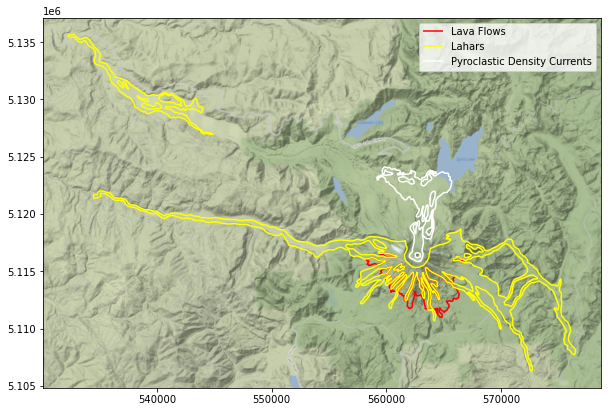

In [8]:
f,ax=plt.subplots(figsize=(10,10))
lava_flows.geometry.boundary.plot(ax=ax,color='red',label='Lava Flows')
lahars.geometry.boundary.plot(ax=ax,color='yellow',label='Lahars')
pyroclastic.geometry.boundary.plot(ax=ax,color='white',label='Pyroclastic Density Currents')
ctx.add_basemap(ax=ax, crs=ts_ds.rio.crs, source=ctx.providers.Stamen.Terrain, attribution=False)
ax.legend()

## Sentinel-1 Overpass Times Context

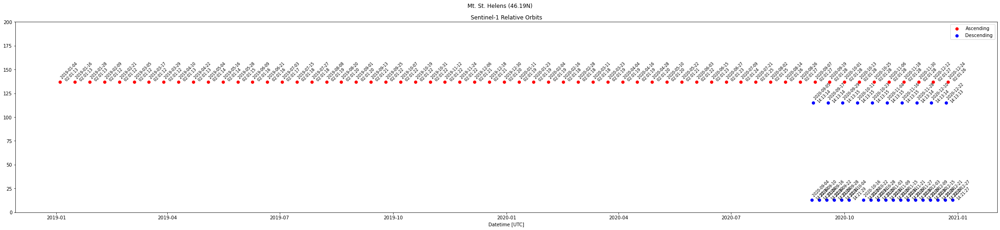

In [9]:
f,ax=plt.subplots(figsize=(30,7))
    
s1_rtc_bs_utils.plot_sentinel1_acquisitons(ts_ds,ax=ax)
f.suptitle(f'{name}')
plt.tight_layout()

In [10]:
bbox_gdf = gpd.read_file(geojson)
ts_ds = s1_rtc_bs_utils.get_s1_rtc_stac(bbox_gdf,start_time='2019-11-01',end_time='2020-01-15',orbit_direction='all',polarization='gamma0_vv',collection=collection)
ts_ds = ts_ds.compute()
ts_ds = ts_ds.dropna('time',how='all')

## Sentinel-1 Overpass Times Around Time of Interest

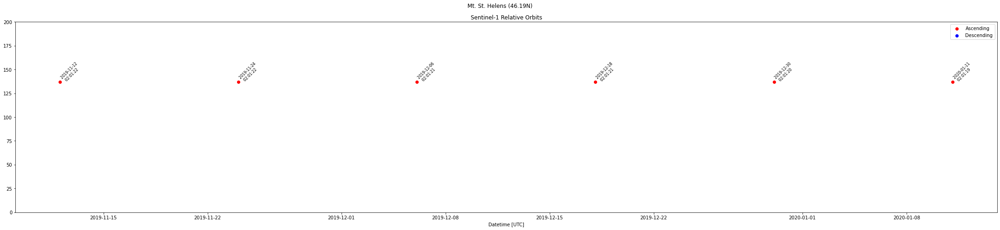

In [11]:
f,ax=plt.subplots(figsize=(30,7))
    
s1_rtc_bs_utils.plot_sentinel1_acquisitons(ts_ds,ax=ax)
f.suptitle(f'{name}')
plt.tight_layout()

In [12]:
bbox_gdf = gpd.read_file(geojson)
ts_ds = s1_rtc_bs_utils.get_s1_rtc_stac(bbox_gdf,start_time='2019-08-01',end_time='2020-08-01',orbit_direction='all',polarization='gamma0_vv',collection=collection)
ts_ds = ts_ds.compute()
ts_ds = ts_ds.dropna('time',how='all')

## Sentinel-1 Backscatter Time Series Context (August 2019-August 2020)

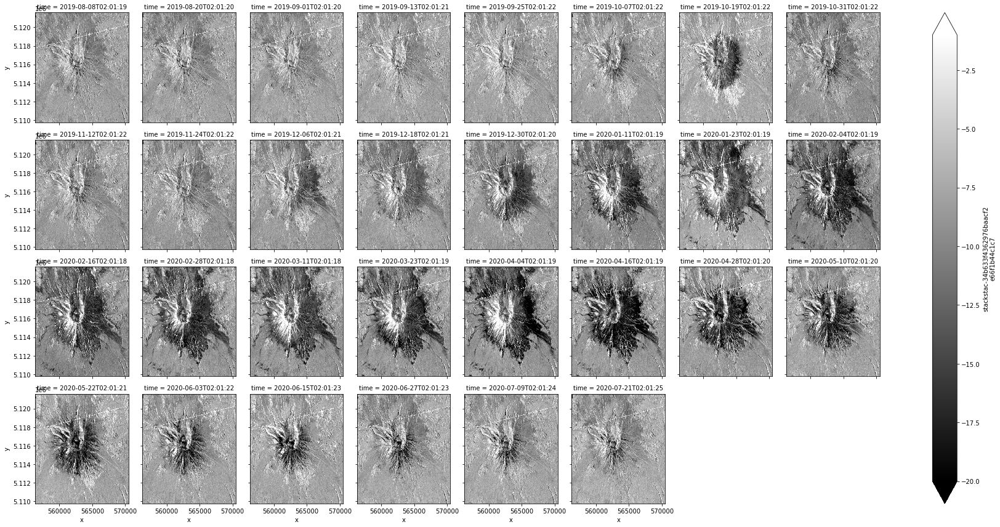

In [13]:
ts_ds_db = 10.0*np.log10(ts_ds)
ts_ds_db.plot(col='time',col_wrap=8,robust=False,cmap='gray',vmin=-20,vmax=-1)

In [14]:
ts_ds = s1_rtc_bs_utils.get_s1_rtc_stac(bbox_gdf,start_time='2019-11-01',end_time='2020-02-01',orbit_direction='all',polarization='gamma0_vv',collection=collection)
ts_ds = ts_ds.compute()
ts_ds = ts_ds.dropna('time',how='all')

## Sentinel-1 Backscatter Time Series Around Time of Interest (November 2019-February 2020)

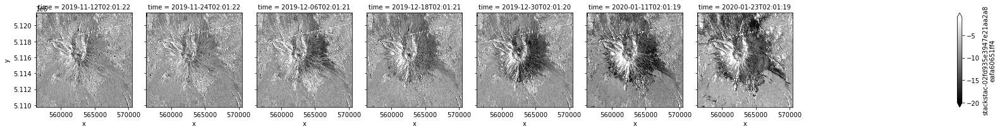

In [15]:
ts_ds_db = 10.0*np.log10(ts_ds)
ts_ds_db.plot(col='time',col_wrap=8,robust=False,cmap='gray',vmin=-20,vmax=-1)

## Let's check Sentinel-2 RGB and NDSI

In [16]:
rgb=s1_rtc_bs_utils.get_s2_rgb(ts_ds,cloud_cover_threshold=100)
new_rgb = np.clip(rgb/np.amax(rgb),0,1)

In [17]:
ndsi=s1_rtc_bs_utils.get_s2_ndsi(ts_ds,cloud_cover_threshold=100)

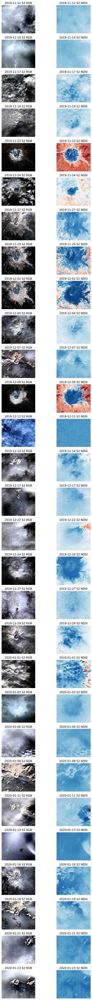

In [18]:
f,ax=plt.subplots(min(len(ndsi.time),len(rgb.time)),2,figsize=(8,60))

for i in range(min(len(ndsi.time),len(rgb.time))):
    new_rgb.isel(time=i).plot.imshow(ax=ax[i,0],rgb='band',robust=True)
    ndsi.isel(time=i).plot.imshow(ax=ax[i,1],add_colorbar=False,cmap='RdBu',vmin=-1,vmax=1)
    #ndwi.isel(time=i).plot.imshow(ax=ax[i,2],add_colorbar=False,vmin=-1,vmax=1)

    ax[i,0].set_aspect('equal')
    ax[i,1].set_aspect('equal')
    #ax[i,2].set_aspect('equal')

    ax[i,0].axis('off')
    ax[i,1].axis('off')
    #ax[i,2].axis('off')

    
    ax[i,0].set_title(f'{pd.to_datetime(rgb.time.values[i]).strftime("%Y-%m-%d")} S2 RGB')
    ax[i,1].set_title(f'{pd.to_datetime(rgb.time.values[i]).strftime("%Y-%m-%d")} S2 NDSI')
    #ax[i,2].set_title(f'{pd.to_datetime(rgb.time.values[i]).strftime("%Y-%m-%d")} S2 NDWI')


    
plt.tight_layout()

In [19]:
ts_ds = s1_rtc_bs_utils.get_s1_rtc_stac(bbox_gdf,start_time='2019-08-01',end_time='2020-08-01',orbit_direction='all',polarization='gamma0_vv',collection=collection)
ts_ds = ts_ds.compute()
ts_ds = ts_ds.dropna('time',how='all')

In [20]:
runoff_onset_map = s1_rtc_bs_utils.get_runoff_onset(ts_ds).dt.dayofyear

## Let's look at the Runoff Onset Date Map

(5109770.0, 5121590.0)

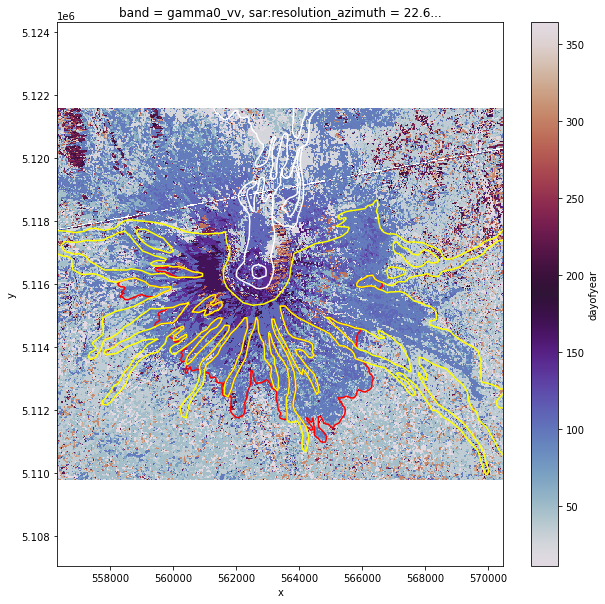

In [21]:
f,ax=plt.subplots(figsize=(10,10))
runoff_onset_map.plot(ax=ax,cmap='twilight')
ax.axis('equal')
lava_flows.geometry.boundary.plot(ax=ax,color='red',label='Lava Flows')
lahars.geometry.boundary.plot(ax=ax,color='yellow',label='Lahars')
pyroclastic.geometry.boundary.plot(ax=ax,color='white',label='Pyroclastic Density Currents')
minx, miny, maxx, maxy = ts_ds.rio.bounds()
ax.set_xlim([minx,maxx])
ax.set_ylim([miny,maxy])

#### Looks like these regions have snowmelt runoff dates early in the year. Does not necessarily mean snow is melting at other times, just least backscatter returned at these times. 

## Check SNOTEL for validation. This S2 RGB and NDSI image is taken December 9th.

In [22]:
all_geoms = lava_flows.geometry.append(lahars.geometry)
all_geoms = all_geoms.geometry.append(pyroclastic.geometry)

In [23]:
sites_gdf = s1_rtc_bs_utils.find_closest_snotel(ts_ds.rio.clip(all_geoms.geometry,all_geoms.crs,drop=True,invert=False)) 
distance_cutoff = 5
sites_gdf = sites_gdf[sites_gdf['distance_km']<distance_cutoff]

(5109615.0, 5121735.0)

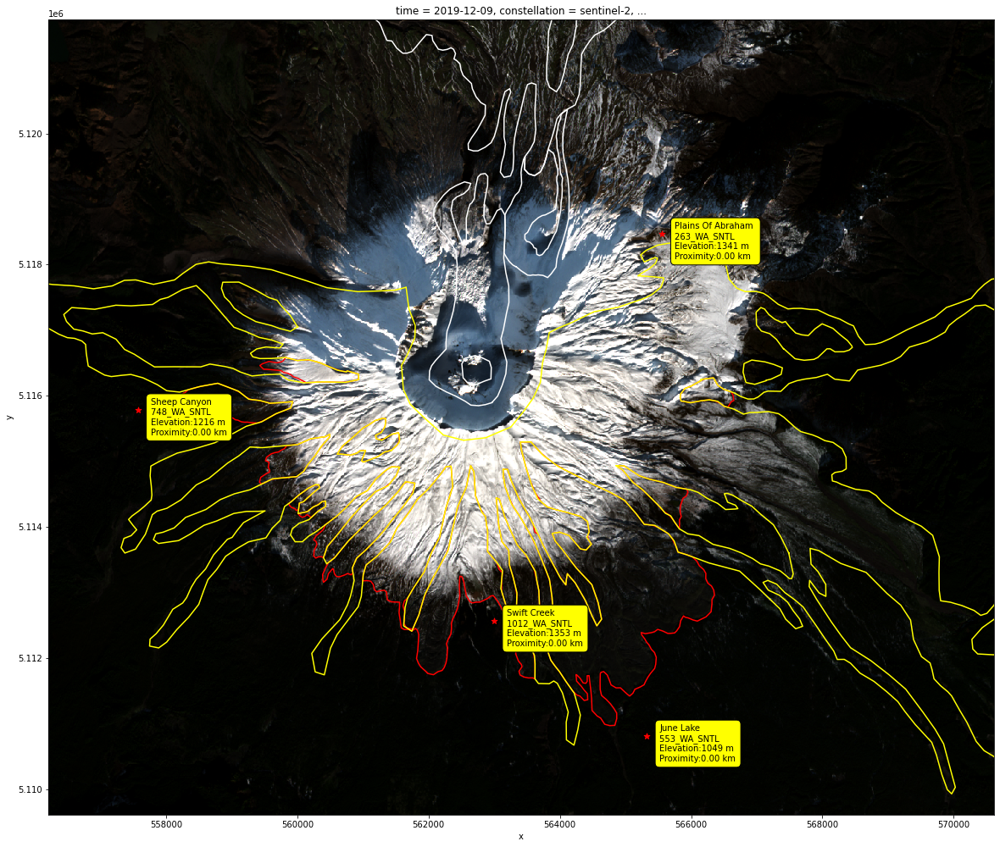

In [24]:
f,ax=plt.subplots(figsize=(20,20))
#ctx.add_basemap(ax=ax, crs=new_rgb.rio.crs, source=ctx.providers.Stamen.Terrain, attribution=False)

new_rgb.isel(time=11).plot.imshow(ax=ax,rgb='band',alpha=1,robust=True)
sites_gdf.plot(ax=ax,marker='*',color='red',markersize=50)
lava_flows.geometry.boundary.plot(ax=ax,color='red',label='Lava Flows')
lahars.geometry.boundary.plot(ax=ax,color='yellow',label='Lahars')
pyroclastic.geometry.boundary.plot(ax=ax,color='white',label='Pyroclastic Density Currents')

for x, y, label1, label2, label3, label4 in zip(sites_gdf.geometry.x, sites_gdf.geometry.y, sites_gdf.name, sites_gdf.code, sites_gdf.distance_km, sites_gdf.elevation_m):
        ax.annotate(f'{label1} \n{label2} \nElevation:{label4:.0f} m \nProximity:{label3:.2f} km', xy=(x, y), xytext=(15, -30), textcoords="offset points", fontsize=10,bbox=dict(facecolor='yellow', edgecolor='black', boxstyle='round,pad=0.5'))
        
minx, miny, maxx, maxy = new_rgb.rio.bounds()
ax.set_xlim([minx,maxx])
ax.set_ylim([miny,maxy])    

## Let's do some stretching so we can see what's happening in these darker areas.

(5109615.0, 5121735.0)

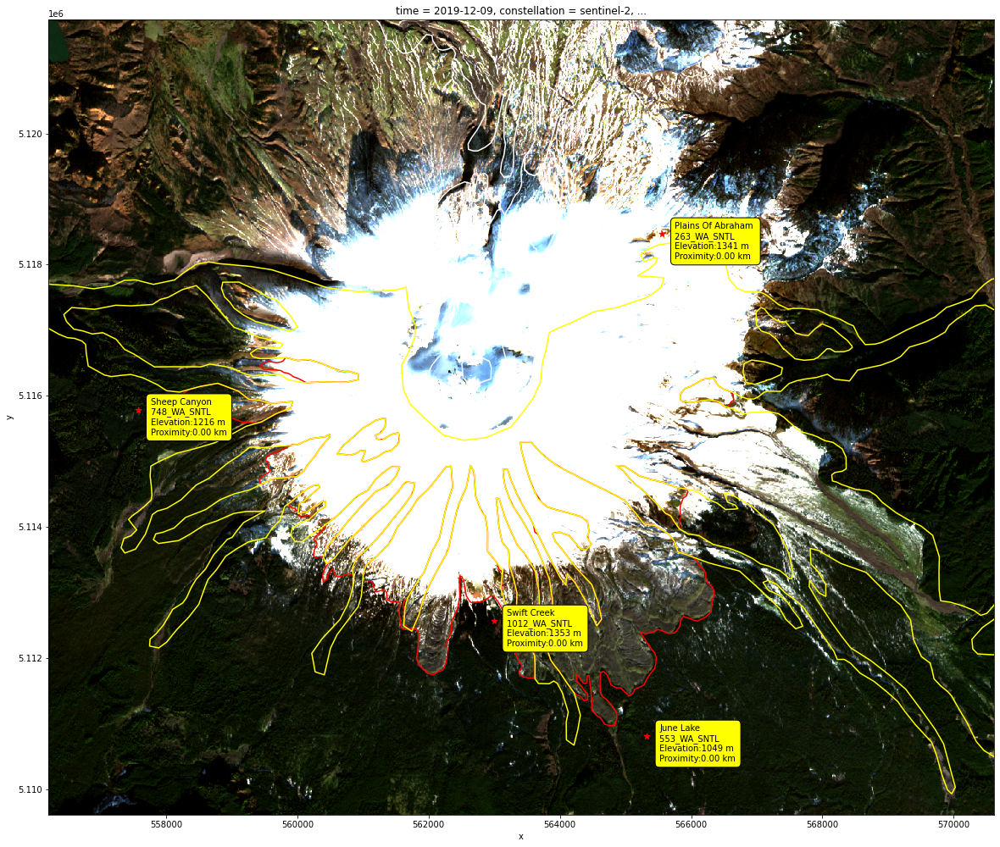

In [25]:
f,ax=plt.subplots(figsize=(20,20))
#ctx.add_basemap(ax=ax, crs=new_rgb.rio.crs, source=ctx.providers.Stamen.Terrain, attribution=False)

new_rgb.isel(time=11).plot.imshow(ax=ax,rgb='band',alpha=1,vmin=0,vmax=0.1)
sites_gdf.plot(ax=ax,marker='*',color='red',markersize=50)
lava_flows.geometry.boundary.plot(ax=ax,color='red',label='Lava Flows')
lahars.geometry.boundary.plot(ax=ax,color='yellow',label='Lahars')
pyroclastic.geometry.boundary.plot(ax=ax,color='white',label='Pyroclastic Density Currents')

for x, y, label1, label2, label3, label4 in zip(sites_gdf.geometry.x, sites_gdf.geometry.y, sites_gdf.name, sites_gdf.code, sites_gdf.distance_km, sites_gdf.elevation_m):
        ax.annotate(f'{label1} \n{label2} \nElevation:{label4:.0f} m \nProximity:{label3:.2f} km', xy=(x, y), xytext=(15, -30), textcoords="offset points", fontsize=10,bbox=dict(facecolor='yellow', edgecolor='black', boxstyle='round,pad=0.5'))
        
minx, miny, maxx, maxy = new_rgb.rio.bounds()
ax.set_xlim([minx,maxx])
ax.set_ylim([miny,maxy])    

## Zooming in...

(5110972.13344892, 5116583.178967105)

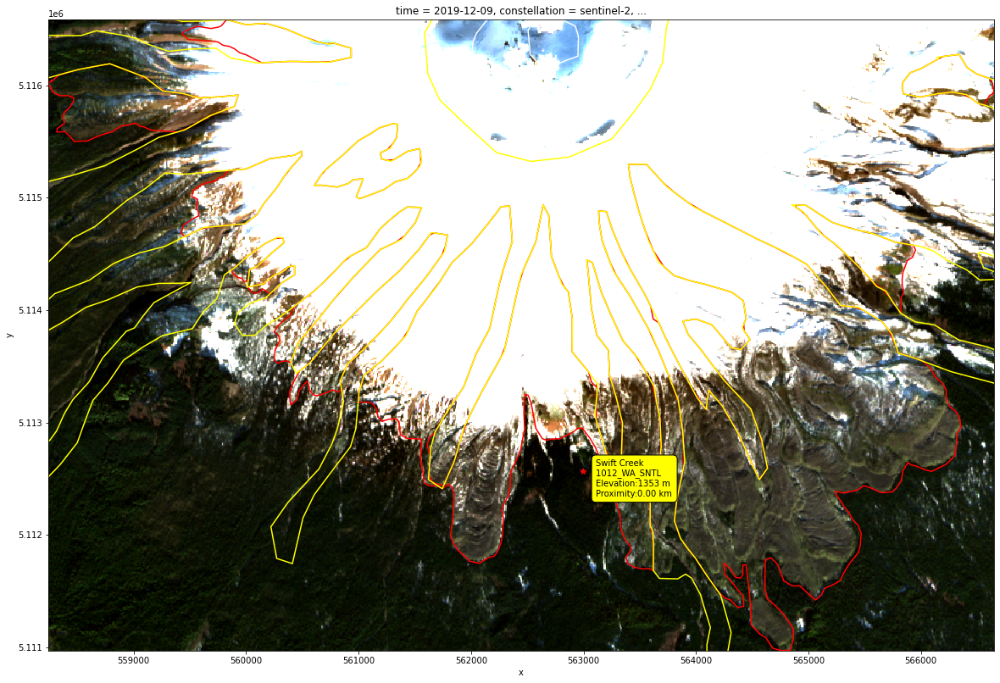

In [26]:
f,ax=plt.subplots(figsize=(20,20))
#ctx.add_basemap(ax=ax, crs=new_rgb.rio.crs, source=ctx.providers.Stamen.Terrain, attribution=False)

new_rgb.isel(time=11).plot.imshow(ax=ax,rgb='band',alpha=1,vmin=0,vmax=0.1)
sites_gdf.plot(ax=ax,marker='*',color='red',markersize=50)
lava_flows.geometry.boundary.plot(ax=ax,color='red',label='Lava Flows')
lahars.geometry.boundary.plot(ax=ax,color='yellow',label='Lahars')
pyroclastic.geometry.boundary.plot(ax=ax,color='white',label='Pyroclastic Density Currents')

for x, y, label1, label2, label3, label4 in zip(sites_gdf.geometry.x, sites_gdf.geometry.y, sites_gdf.name, sites_gdf.code, sites_gdf.distance_km, sites_gdf.elevation_m):
        ax.annotate(f'{label1} \n{label2} \nElevation:{label4:.0f} m \nProximity:{label3:.2f} km', xy=(x, y), xytext=(15, -30), textcoords="offset points", fontsize=10,bbox=dict(facecolor='yellow', edgecolor='black', boxstyle='round,pad=0.5'))
        
minx, miny, maxx, maxy = lava_flows.total_bounds
ax.set_xlim([minx,maxx])
ax.set_ylim([miny,maxy]) 

## NDSI Plot for the same scene....

(5109615.0, 5121735.0)

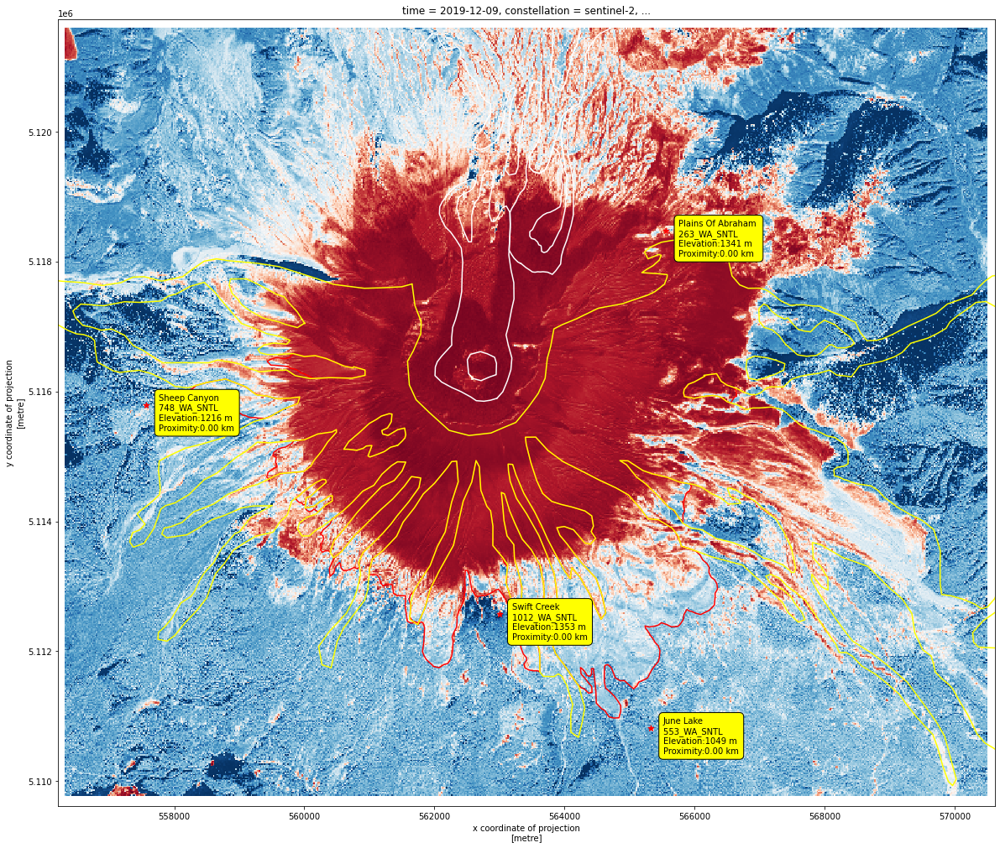

In [27]:
f,ax=plt.subplots(figsize=(20,20))
#ctx.add_basemap(ax=ax, crs=new_rgb.rio.crs, source=ctx.providers.Stamen.Terrain, attribution=False)

ndsi.isel(time=11).plot.imshow(ax=ax,alpha=1,add_colorbar=False)
sites_gdf.plot(ax=ax,marker='*',color='red',markersize=50)
lava_flows.geometry.boundary.plot(ax=ax,color='red',label='Lava Flows')
lahars.geometry.boundary.plot(ax=ax,color='yellow',label='Lahars')
pyroclastic.geometry.boundary.plot(ax=ax,color='white',label='Pyroclastic Density Currents')

for x, y, label1, label2, label3, label4 in zip(sites_gdf.geometry.x, sites_gdf.geometry.y, sites_gdf.name, sites_gdf.code, sites_gdf.distance_km, sites_gdf.elevation_m):
        ax.annotate(f'{label1} \n{label2} \nElevation:{label4:.0f} m \nProximity:{label3:.2f} km', xy=(x, y), xytext=(15, -30), textcoords="offset points", fontsize=10,bbox=dict(facecolor='yellow', edgecolor='black', boxstyle='round,pad=0.5'))
        
minx, miny, maxx, maxy = new_rgb.rio.bounds()
ax.set_xlim([minx,maxx])
ax.set_ylim([miny,maxy])    

## Zooming in...

(5110972.13344892, 5116583.178967105)

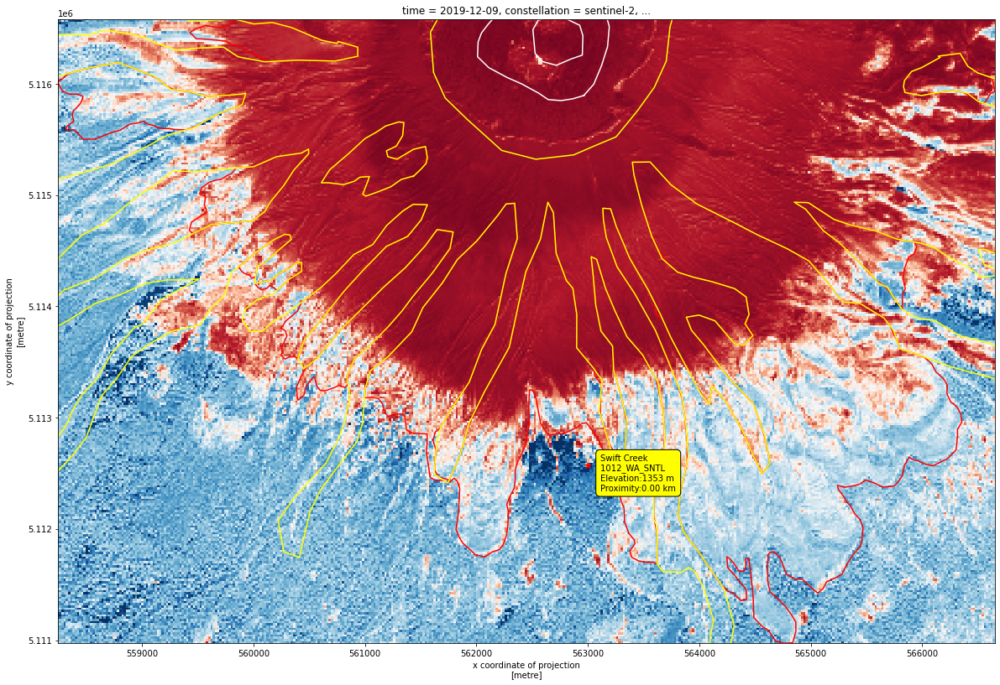

In [28]:
f,ax=plt.subplots(figsize=(20,20))
#ctx.add_basemap(ax=ax, crs=new_rgb.rio.crs, source=ctx.providers.Stamen.Terrain, attribution=False)

ndsi.isel(time=11).plot.imshow(ax=ax,alpha=1,add_colorbar=False)
sites_gdf.plot(ax=ax,marker='*',color='red',markersize=50)
lava_flows.geometry.boundary.plot(ax=ax,color='red',label='Lava Flows')
lahars.geometry.boundary.plot(ax=ax,color='yellow',label='Lahars')
pyroclastic.geometry.boundary.plot(ax=ax,color='white',label='Pyroclastic Density Currents')

for x, y, label1, label2, label3, label4 in zip(sites_gdf.geometry.x, sites_gdf.geometry.y, sites_gdf.name, sites_gdf.code, sites_gdf.distance_km, sites_gdf.elevation_m):
        ax.annotate(f'{label1} \n{label2} \nElevation:{label4:.0f} m \nProximity:{label3:.2f} km', xy=(x, y), xytext=(15, -30), textcoords="offset points", fontsize=10,bbox=dict(facecolor='yellow', edgecolor='black', boxstyle='round,pad=0.5'))
        
minx, miny, maxx, maxy = lava_flows.total_bounds
ax.set_xlim([minx,maxx])
ax.set_ylim([miny,maxy])    

## General rule is NDSI > 0 has some snow in the pixel, let's mask and only include pixels with NDSI > 0

(5110972.13344892, 5116583.178967105)

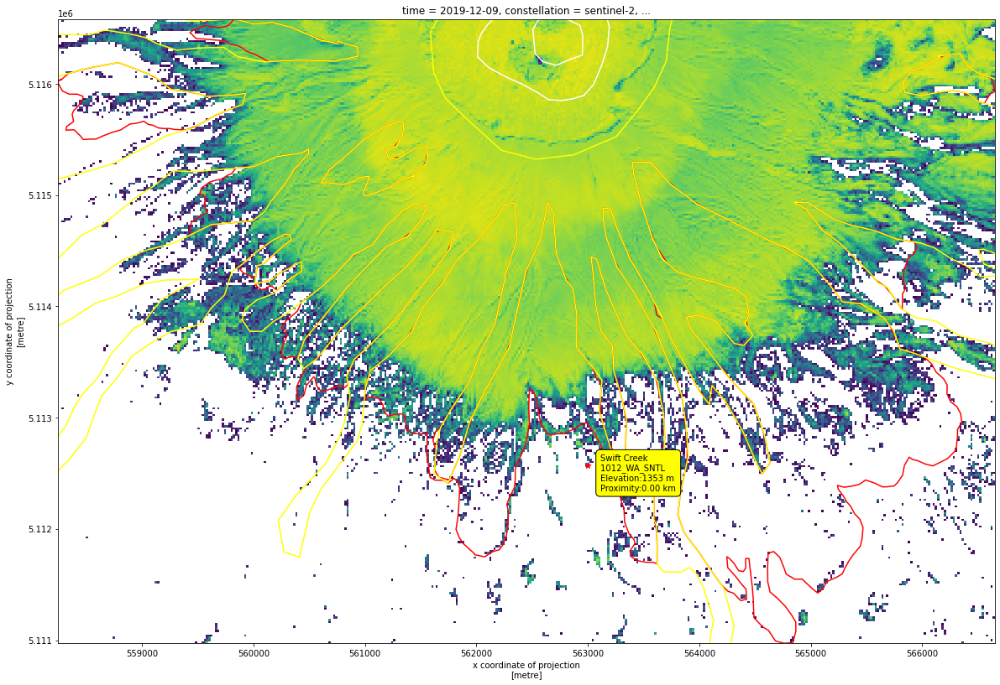

In [29]:
f,ax=plt.subplots(figsize=(20,20))
#ctx.add_basemap(ax=ax, crs=new_rgb.rio.crs, source=ctx.providers.Stamen.Terrain, attribution=False)

ndsi.isel(time=11).where(ndsi.isel(time=11)>0).plot.imshow(ax=ax,alpha=1,add_colorbar=False)
sites_gdf.plot(ax=ax,marker='*',color='red',markersize=50)
lava_flows.geometry.boundary.plot(ax=ax,color='red',label='Lava Flows')
lahars.geometry.boundary.plot(ax=ax,color='yellow',label='Lahars')
pyroclastic.geometry.boundary.plot(ax=ax,color='white',label='Pyroclastic Density Currents')

for x, y, label1, label2, label3, label4 in zip(sites_gdf.geometry.x, sites_gdf.geometry.y, sites_gdf.name, sites_gdf.code, sites_gdf.distance_km, sites_gdf.elevation_m):
        ax.annotate(f'{label1} \n{label2} \nElevation:{label4:.0f} m \nProximity:{label3:.2f} km', xy=(x, y), xytext=(15, -30), textcoords="offset points", fontsize=10,bbox=dict(facecolor='yellow', edgecolor='black', boxstyle='round,pad=0.5'))
        
minx, miny, maxx, maxy = lava_flows.total_bounds
ax.set_xlim([minx,maxx])
ax.set_ylim([miny,maxy])    

In [30]:
snotel_data = s1_rtc_bs_utils.get_closest_snotel_data(ts_ds,variable_code='SNOTEL:SNWD_D',distance_cutoff=1,start_date='2019-12-01', end_date='2020-01-01')
snotel_data = 2.54*snotel_data

Unable to fetch SNOTEL:SNWD_D
263_WA_SNTL data missing


## Looks like snow present in target areas on Dec 9th. Let's see the context image again so we remember where the SNOTEL stations are.

(5109615.0, 5121735.0)

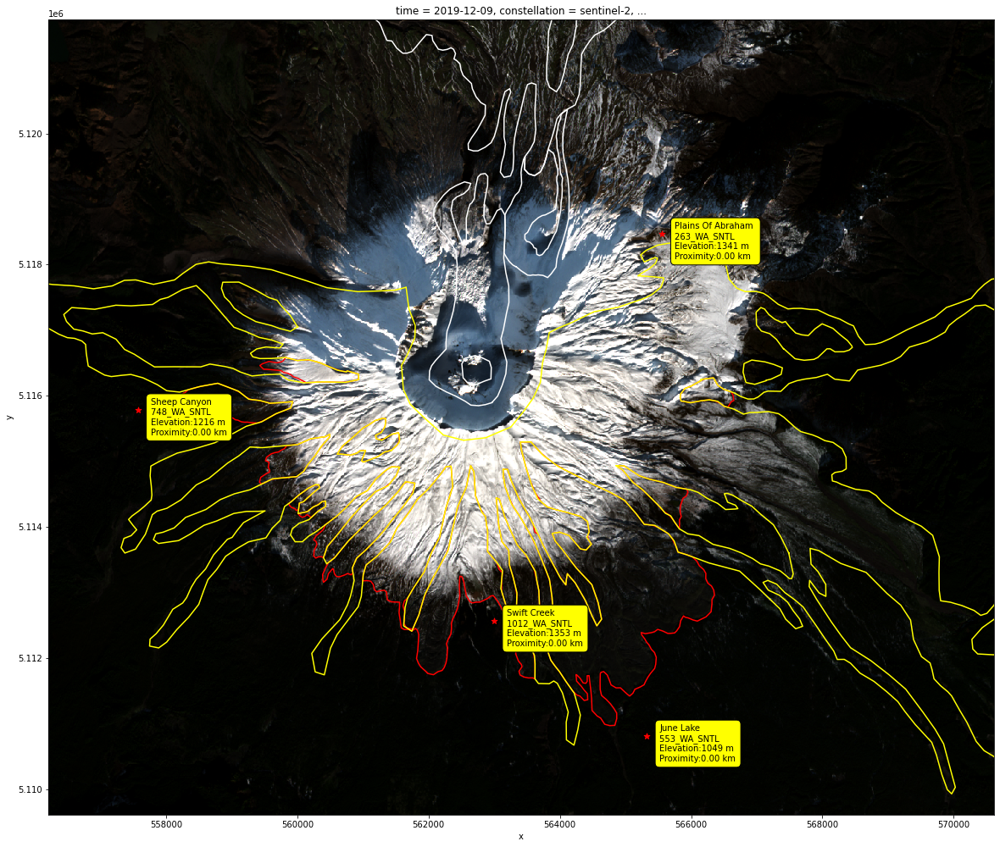

In [31]:
f,ax=plt.subplots(figsize=(20,20))
#ctx.add_basemap(ax=ax, crs=new_rgb.rio.crs, source=ctx.providers.Stamen.Terrain, attribution=False)

new_rgb.isel(time=11).plot.imshow(ax=ax,rgb='band',alpha=1,robust=True)
sites_gdf.plot(ax=ax,marker='*',color='red',markersize=50)
lava_flows.geometry.boundary.plot(ax=ax,color='red',label='Lava Flows')
lahars.geometry.boundary.plot(ax=ax,color='yellow',label='Lahars')
pyroclastic.geometry.boundary.plot(ax=ax,color='white',label='Pyroclastic Density Currents')

for x, y, label1, label2, label3, label4 in zip(sites_gdf.geometry.x, sites_gdf.geometry.y, sites_gdf.name, sites_gdf.code, sites_gdf.distance_km, sites_gdf.elevation_m):
        ax.annotate(f'{label1} \n{label2} \nElevation:{label4:.0f} m \nProximity:{label3:.2f} km', xy=(x, y), xytext=(15, -30), textcoords="offset points", fontsize=10,bbox=dict(facecolor='yellow', edgecolor='black', boxstyle='round,pad=0.5'))
        
minx, miny, maxx, maxy = new_rgb.rio.bounds()
ax.set_xlim([minx,maxx])
ax.set_ylim([miny,maxy])    

## And now the SNOTEL data from these stations (263 Plains of Abraham seem to be missing SNWD_D)

In [32]:
snotel_temp = s1_rtc_bs_utils.get_closest_snotel_data(ts_ds,variable_code='SNOTEL:TAVG_D',distance_cutoff=1,start_date='2019-12-01', end_date='2020-01-01')
snotel_temp=(snotel_temp-32)/1.8

Unable to fetch SNOTEL:TAVG_D
263_WA_SNTL data missing


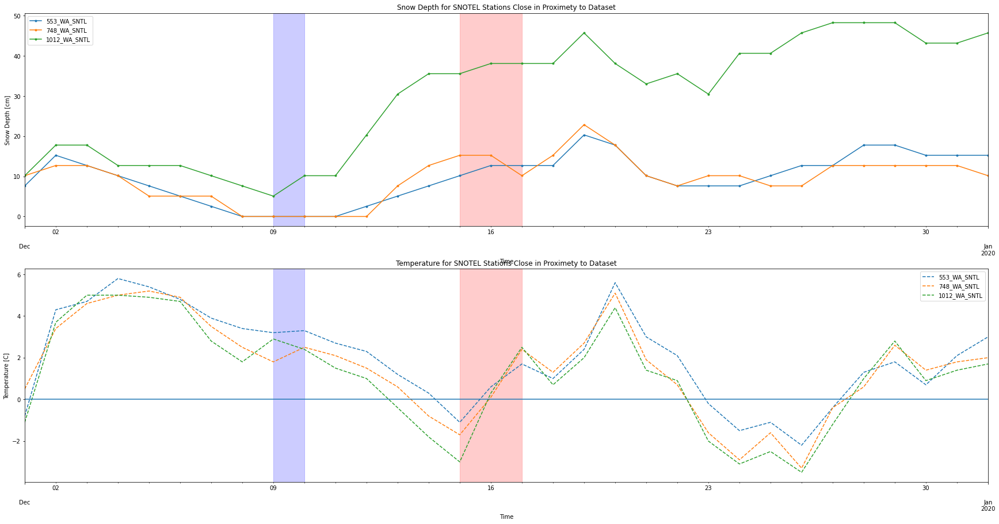

In [33]:
f, ax = plt.subplots(2,1,figsize=(30,15))
#ax2=plt.twinx()
snotel_data.plot(ax=ax[0],marker='.')
ax[0].set_xlabel('Time')
ax[0].set_ylabel('Snow Depth [cm]')
ax[0].set_title('Snow Depth for SNOTEL Stations Close in Proximety to Dataset')
ax[0].axvspan('2019-12-09', '2019-12-10', alpha=0.2, color='blue')
ax[0].axvspan('2019-12-15', '2019-12-17', alpha=0.2, color='red')

snotel_temp.plot(linestyle='--',ax=ax[1])
ax[1].set_xlabel('Time')
ax[1].set_ylabel('Temperature [C]')
ax[1].hlines(xmin='2019-12-01',xmax='2020-01-01',y=0)
ax[1].set_title('Temperature for SNOTEL Stations Close in Proximety to Dataset')
ax[1].axvspan('2019-12-09', '2019-12-10', alpha=0.2, color='blue')
ax[1].axvspan('2019-12-15', '2019-12-17', alpha=0.2, color='red')

#### So the Sentinel-2 imagery was taken around the blue region, and our time of interest is in the red region. During the S2 overpass, we already have snow present in the target areas. From this time until the red region, the snow depth (at the SNOTEL sites) only increases. Generally, we would also expect for snow cover to increase in the surrounding areas during this time as well. Rain might complicate this a bit though.

## Let's overlay all variables (Context)

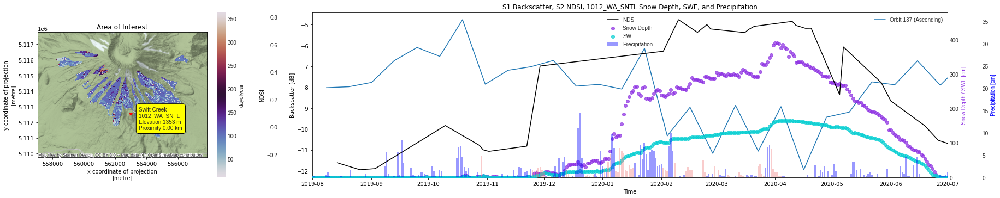

In [34]:
s1_rtc_bs_utils.plot_bs_ndsi_swe_precip_with_context(ts_ds.rio.clip(lava_flows.geometry,lava_flows.crs,drop=True,invert=False),start_date='2019-08-01',end_date='2020-07-01')

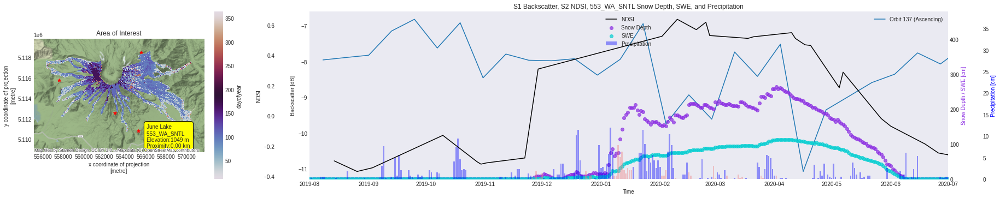

In [35]:
s1_rtc_bs_utils.plot_bs_ndsi_swe_precip_with_context(ts_ds.rio.clip(lahars.geometry,lahars.crs,drop=True,invert=False),start_date='2019-08-01',end_date='2020-07-01')

In [36]:
#s1_rtc_bs_utils.plot_bs_ndsi_swe_precip_with_context(ts_ds.rio.clip(pyroclastic.geometry,pyroclastic.crs,drop=True,invert=False),start_date='2019-08-01',end_date='2020-07-01')

## Let's overlay all variables (Around time of interest)

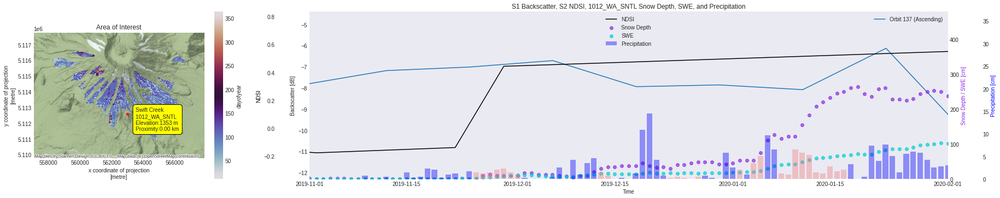

In [37]:
s1_rtc_bs_utils.plot_bs_ndsi_swe_precip_with_context(ts_ds.rio.clip(lava_flows.geometry,lava_flows.crs,drop=True,invert=False),start_date='2019-11-01',end_date='2020-02-01')

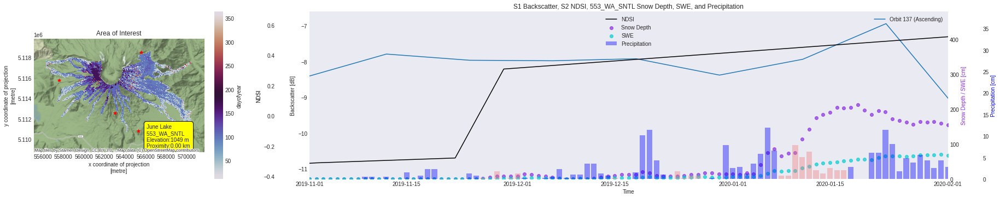

In [38]:
s1_rtc_bs_utils.plot_bs_ndsi_swe_precip_with_context(ts_ds.rio.clip(lahars.geometry,lahars.crs,drop=True,invert=False),start_date='2019-11-01',end_date='2020-02-01')

In [39]:
#s1_rtc_bs_utils.plot_bs_ndsi_swe_precip_with_context(ts_ds.rio.clip(pyroclastic.geometry,pyroclastic.crs,drop=True,invert=False),start_date='2019-11-01',end_date='2020-02-01')

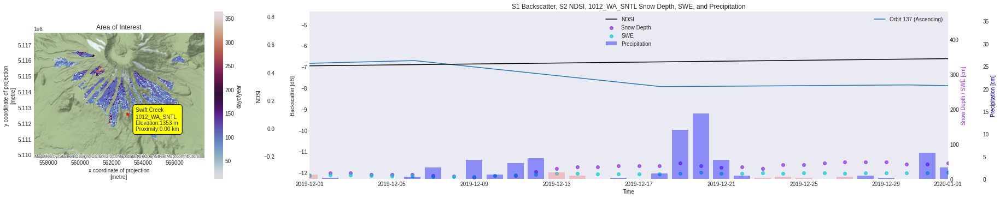

In [40]:
s1_rtc_bs_utils.plot_bs_ndsi_swe_precip_with_context(ts_ds.rio.clip(lava_flows.geometry,lava_flows.crs,drop=True,invert=False),start_date='2019-12-01',end_date='2020-01-01')

## What elevations are we looking at? Swift Creek SNOTEL site is at 1353m

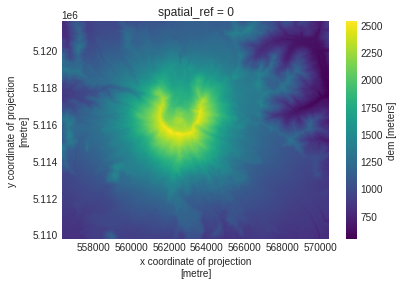

In [41]:
dem = s1_rtc_bs_utils.get_py3dep_dem(ts_ds)
dem.plot()

#### Most of the AOIs are above the SNOTEL site so we expect colder temps + more snow

## Let's look at Plains of Abraham SNOTEL station next

## Curious when does runoff happen at different elevations

Text(0.5, 0.98, 'Mt. St. Helens Sentinel-1 SAR Backscatter binned by Elevation \n (Runoff onset happens at the backscatter minimum / darkest pixels) \n each row: backscatter means for a given 100m elevation bin \n top 2 rows are all data, bottom 2 rows are 2 week resampled means')

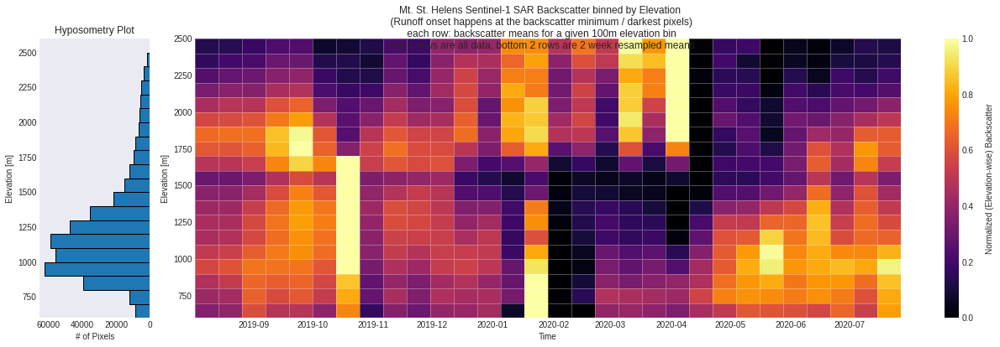

In [42]:
f,ax=plt.subplots(1,2,figsize=(18,6),gridspec_kw={'width_ratios': [1, 8]})
s1_rtc_bs_utils.plot_timeseries_by_elevation_bin(ts_ds,dem,bin_size=100,ax=ax[1],normalize_bins=True)
s1_rtc_bs_utils.plot_hyposometry(ts_ds,dem,bin_size=100,ax=ax[0])

ax[0].invert_xaxis()

#plt.tight_layout()
f.tight_layout(rect=[0, 0.03, 1, 0.95])
f.suptitle("Mt. St. Helens Sentinel-1 SAR Backscatter binned by Elevation \n (Runoff onset happens at the backscatter minimum / darkest pixels) \n each row: backscatter means for a given 100m elevation bin \n top 2 rows are all data, bottom 2 rows are 2 week resampled means")

In [43]:
name = 'Mt. St. Helens [South Face] (46.19N)'
geojson = '../input/MSH_shapefiles/MSH_south.geojson'     
collection = '../input/sentinel1-rtc-aws/mycollection_helens.json'        

In [44]:
bbox_gdf = gpd.read_file(geojson)
ts_ds = s1_rtc_bs_utils.get_s1_rtc_stac(bbox_gdf,start_time='2019-01-01',end_time='2021-01-01',orbit_direction='all',polarization='gamma0_vv',collection=collection)
ts_ds = ts_ds.compute()
ts_ds = ts_ds.dropna('time',how='all')

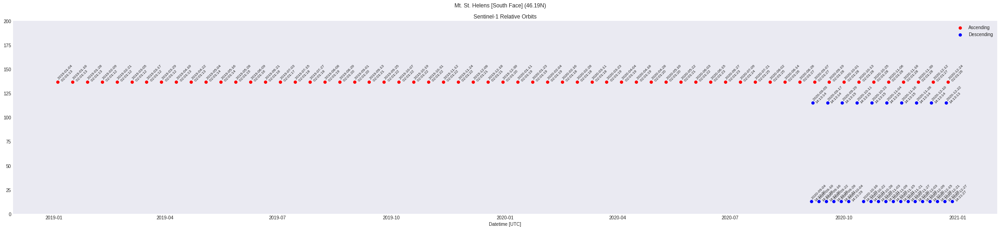

In [45]:
f,ax=plt.subplots(figsize=(30,7))
    
s1_rtc_bs_utils.plot_sentinel1_acquisitons(ts_ds,ax=ax)
f.suptitle(f'{name}')
plt.tight_layout()

In [132]:
def plot_bs_ndsi_swe_precip_with_context(ts_ds,start_date='1900-01-01', end_date=datetime.today().strftime('%Y-%m-%d')):
    
    f,ax=plt.subplots(1,2,figsize=(25,5),gridspec_kw={'width_ratios': [1, 3]})
    
    plt.style.use('seaborn-dark')

    #snwd_ax = ax[1].twinx()
    precip_ax = ax[1].twinx()
    #ndsi_ax = ax[1].twinx()
    
    #host.set_xlim(0, 2)
    #host.set_ylim(0, 2)
    #par1.set_ylim(0, 4)
    #par2.set_ylim(1, 65)
    #snwd_ax.set_ylim(bottom=0)
    ax[1].set_ylim([0,60])

    
    ax[1].set_xlabel("Time")
    #ax[1].set_ylabel("Backscatter [dB]")
    ax[1].set_ylabel("Snow Depth / SWE [cm]")
    precip_ax.set_ylabel("Precipitation [cm]")
    #ndsi_ax.set_ylabel("NDSI")

    #bs_plot1, = ax[1].plot(ts_ds[ts_ds.coords['sat:orbit_state']=='ascending'].time,ts_ds[ts_ds.coords['sat:orbit_state']=='ascending'].mean(dim=['x','y']),color='red',label='Backscatter (Ascending)')
    #bs_plot2, = ax[1].plot(ts_ds[ts_ds.coords['sat:orbit_state']=='descending'].time,ts_ds[ts_ds.coords['sat:orbit_state']=='descending'].mean(dim=['x','y']),color='orange',label='Backscatter (Descending)')

#    for orbit in np.unique(ts_ds.coords['sat:relative_orbit']):
#        direction = ts_ds[ts_ds.coords['sat:relative_orbit']==orbit]['sat:orbit_state'].values[0].capitalize()
#        ax[1].plot(ts_ds[ts_ds.coords['sat:relative_orbit']==orbit].time,10.0*np.log10(ts_ds[ts_ds.coords['sat:relative_orbit']==orbit].mean(dim=['x','y'])),label=f'Orbit {orbit} ({direction})')
    #ax[1].legend()
    
    
    #snow = s1_rtc_bs_utils.get_s2_ndsi(ts_ds)
    #ndsi_plot, = ndsi_ax.plot(snow.time,snow.mean(dim=['x','y']),color='black',label='NDSI')

    
    #print(snotel_snwd)
    #ax.scatter(x=snotel_snwd.index,y=snotel_snwd['value'],label='Snow Depth')
    snotel_precip = s1_rtc_bs_utils.get_closest_snotel_data(ts_ds,variable_code='SNOTEL:PRCPSA_D',distance_cutoff=30,closest=True,start_date='1900-01-01', end_date=datetime.today().strftime('%Y-%m-%d'))
    snotel_temp = s1_rtc_bs_utils.get_closest_snotel_data(ts_ds,variable_code='SNOTEL:TAVG_D',distance_cutoff=30,closest=True,start_date='1900-01-01', end_date=datetime.today().strftime('%Y-%m-%d'))
    snotel_temp=(snotel_temp-32)/1.8
    temp_precip_gdf = pd.concat([snotel_temp,snotel_precip],axis=1,join='inner')
    temp_precip_gdf.set_axis(['Temperature','Precip'],axis=1,inplace=True)
    conditions = [(temp_precip_gdf['Temperature'] <=0),(temp_precip_gdf['Temperature'] > 0)]
    values = ['lightcoral', 'blue']
    temp_precip_gdf['bar_color'] = np.select(conditions, values)
    
    
    precip_plot = precip_ax.bar(temp_precip_gdf.index,2.54*temp_precip_gdf.iloc[:,1],color=temp_precip_gdf['bar_color'],alpha=0.7,label='Precipitation')

    snotel_snwd = s1_rtc_bs_utils.get_closest_snotel_data(ts_ds,variable_code='SNOTEL:SNWD_D',distance_cutoff=30,closest=True,start_date='1900-01-01', end_date=datetime.today().strftime('%Y-%m-%d'))
    snwd_plot = ax[1].scatter(snotel_snwd.index,2.54*snotel_snwd.iloc[:,0],color='blueviolet',alpha=1,label='Snow Depth',zorder=5)
    
    snotel_swe = s1_rtc_bs_utils.get_closest_snotel_data(ts_ds,variable_code='SNOTEL:WTEQ_D',distance_cutoff=30,closest=True,start_date='1900-01-01', end_date=datetime.today().strftime('%Y-%m-%d'))
    swe_plot = ax[1].scatter(snotel_swe.index,2.54*snotel_swe.iloc[:,0],color='darkturquoise',alpha=1,label='SWE',zorder=5)
    
    lns = [snwd_plot,swe_plot,precip_plot]
    extra_legend = ax[1].legend(handles=lns,loc='upper center')
    ax[1].legend(loc='upper left')
    #ax[1].add_artist(extra_legend)
    #time_slice = slice('2015-01-01','2022-01-01')
    #ax.set_xlim([time_slice.start,time_slice.stop])
    
    precip_ax.spines['right'].set_position(('outward', 10))
    #ndsi_ax.spines['left'].set_position(('outward', 60))
    #ndsi_ax.yaxis.label.set_position(('outward', 60))
    
    #ndsi_ax.spines["left"].set_visible(True)
    #ndsi_ax.yaxis.set_label_position('left') 
    #ndsi_ax.yaxis.set_ticks_position('left')
    
    #ax[1].yaxis.label.set_color(bs_plot1.get_color())
    #ndsi_ax.yaxis.label.set_color(ndsi_plot.get_color())
    ax[1].yaxis.label.set_color('blueviolet')
    precip_ax.yaxis.label.set_color('blue')
    
    ax[1].set_xlim([datetime.strptime(start_date,'%Y-%m-%d'),datetime.strptime(end_date,'%Y-%m-%d')])   
    
    plt.tight_layout()
    
    
    sites_gdf = s1_rtc_bs_utils.find_closest_snotel(ts_ds)
    sites_gdf[sites_gdf['distance_km']==sites_gdf['distance_km'].min()].plot(ax=ax[0],color='red',marker='*')
    
    for x, y, label1, label2, label3, label4 in zip(sites_gdf.geometry.x, sites_gdf.geometry.y, sites_gdf.name, sites_gdf.code, sites_gdf.distance_km, sites_gdf.elevation_m):
        ax[0].annotate(f'{label1} \n{label2} \nElevation:{label4:.0f} m ', xy=(x, y), xytext=(15, -30), textcoords="offset points", fontsize=10,bbox=dict(facecolor='yellow', edgecolor='black', boxstyle='round,pad=0.5'))
        break
    
    minx, miny, maxx, maxy = ts_ds.rio.bounds()
    distance_cutoff=1

    
    #ts_ds.isel(time=0).plot(ax=ax[0],vmax=1.0,cmap='gray',add_colorbar=False)
    #s1_rtc_bs_utils.get_runoff_onset(ts_ds).dt.dayofyear.plot(ax=ax[0],cmap='twilight')

    
    new_rgb.isel(time=11).plot.imshow(ax=ax[0],rgb='band',alpha=1,robust=True)
    #sites_gdf.plot(ax=ax,marker='*',color='red',markersize=50)
    lava_flows.geometry.boundary.plot(ax=ax[0],color='red',label='Lava Flows')
    lahars.geometry.boundary.plot(ax=ax[0],color='yellow',label='Lahars')
    pyroclastic.geometry.boundary.plot(ax=ax[0],color='white',label='Pyroclastic Density Currents')
    
    ax[0].set_xlim([minx-1000*distance_cutoff*1.2,maxx+1000*distance_cutoff*1.2])
    ax[0].set_ylim([miny-1000*distance_cutoff*1.2,maxy+1000*distance_cutoff*1.2])
    
    #ctx.add_basemap(ax=ax[0], crs=ts_ds.rio.crs, source=ctx.providers.Stamen.Terrain)
    ax[0].set_title('Area of Interest')
    
    colors = {'Snow':'lightcoral', 'Rain':'blue'}         
    labels = list(colors.keys())
    handles = [plt.Rectangle((0,0),1,1, color=colors[label]) for label in labels]
    precip_ax.legend(handles, labels, loc='upper right')

    precip_ax.set_ylim([0,25])
    site_name = sites_gdf[sites_gdf['distance_km']==sites_gdf['distance_km'].min()]['code'].values[0]
    ax[1].set_title(f'{site_name} Snow Depth, SWE, and Precipitation')

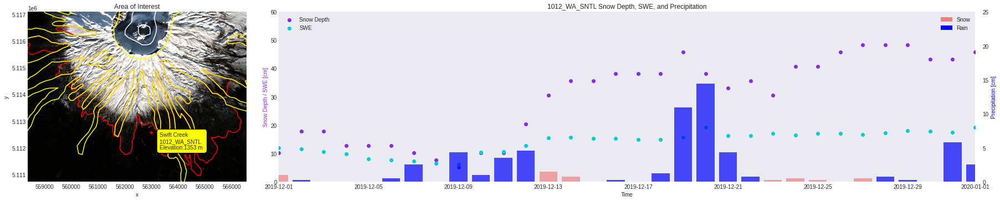

In [133]:
plot_bs_ndsi_swe_precip_with_context(ts_ds.rio.clip(lava_flows.geometry,lava_flows.crs,drop=True,invert=False),start_date='2019-12-01',end_date='2020-01-01')

In [134]:
snotel_sites = s1_rtc_bs_utils.find_closest_snotel(ts_ds)

In [135]:
snotel_sites.iloc[0]['code']

'1012_WA_SNTL'

In [136]:
wsdlurl = 'https://hydroportal.cuahsi.org/Snotel/cuahsi_1_1.asmx?WSDL'
print(ulmo.cuahsi.wof.get_site_info(wsdlurl, 'SNOTEL:1012_WA_SNTL')['series'].keys())


dict_keys(['SNOTEL:BATT_D', 'SNOTEL:BATT_H', 'SNOTEL:PRCP_y', 'SNOTEL:PRCP_sm', 'SNOTEL:PRCP_m', 'SNOTEL:PRCP_wy', 'SNOTEL:PRCPSA_y', 'SNOTEL:PRCPSA_D', 'SNOTEL:PRCPSA_sm', 'SNOTEL:PRCPSA_m', 'SNOTEL:PRCPSA_wy', 'SNOTEL:PREC_sm', 'SNOTEL:PREC_m', 'SNOTEL:PREC_wy', 'SNOTEL:SNWD_D', 'SNOTEL:SNWD_sm', 'SNOTEL:SNWD_H', 'SNOTEL:SNWD_m', 'SNOTEL:TAVG_y', 'SNOTEL:TAVG_D', 'SNOTEL:TAVG_sm', 'SNOTEL:TAVG_m', 'SNOTEL:TAVG_wy', 'SNOTEL:TMAX_y', 'SNOTEL:TMAX_D', 'SNOTEL:TMAX_sm', 'SNOTEL:TMAX_m', 'SNOTEL:TMAX_wy', 'SNOTEL:TMIN_y', 'SNOTEL:TMIN_D', 'SNOTEL:TMIN_sm', 'SNOTEL:TMIN_m', 'SNOTEL:TMIN_wy', 'SNOTEL:TOBS_D', 'SNOTEL:TOBS_sm', 'SNOTEL:TOBS_H', 'SNOTEL:TOBS_m', 'SNOTEL:WTEQ_D', 'SNOTEL:WTEQ_sm', 'SNOTEL:WTEQ_H', 'SNOTEL:WTEQ_m'])


In [141]:
site_info= ulmo.cuahsi.wof.get_site_info(wsdlurl, 'SNOTEL:1012_WA_SNTL')['series']

In [143]:
#site_info

In [295]:
def plot_bs_ndsi_swe_precip_with_context_H(ts_ds,start_date='1900-01-01', end_date=datetime.today().strftime('%Y-%m-%d')):
    
    f,ax=plt.subplots(1,2,figsize=(25,8),gridspec_kw={'width_ratios': [1, 3]})
    
    plt.style.use('seaborn-dark')

    #snwd_ax = ax[1].twinx()
    temp_ax = ax[1].twinx()
    #ndsi_ax = ax[1].twinx()
    
    #host.set_xlim(0, 2)
    #host.set_ylim(0, 2)
    #par1.set_ylim(0, 4)
    #par2.set_ylim(1, 65)
    #snwd_ax.set_ylim(bottom=0)
    ax[1].set_ylim([0,50]) #13,17

    
    ax[1].set_xlabel("Time")
    #ax[1].set_ylabel("Backscatter [dB]")
    ax[1].set_ylabel("Snow Depth / SWE [cm]")
    temp_ax.set_ylabel("Temperature [C]")
    #ndsi_ax.set_ylabel("NDSI")

    #bs_plot1, = ax[1].plot(ts_ds[ts_ds.coords['sat:orbit_state']=='ascending'].time,ts_ds[ts_ds.coords['sat:orbit_state']=='ascending'].mean(dim=['x','y']),color='red',label='Backscatter (Ascending)')
    #bs_plot2, = ax[1].plot(ts_ds[ts_ds.coords['sat:orbit_state']=='descending'].time,ts_ds[ts_ds.coords['sat:orbit_state']=='descending'].mean(dim=['x','y']),color='orange',label='Backscatter (Descending)')

#    for orbit in np.unique(ts_ds.coords['sat:relative_orbit']):
#        direction = ts_ds[ts_ds.coords['sat:relative_orbit']==orbit]['sat:orbit_state'].values[0].capitalize()
#        ax[1].plot(ts_ds[ts_ds.coords['sat:relative_orbit']==orbit].time,10.0*np.log10(ts_ds[ts_ds.coords['sat:relative_orbit']==orbit].mean(dim=['x','y'])),label=f'Orbit {orbit} ({direction})')
    #ax[1].legend()
    
    
    #snow = s1_rtc_bs_utils.get_s2_ndsi(ts_ds)
    #ndsi_plot, = ndsi_ax.plot(snow.time,snow.mean(dim=['x','y']),color='black',label='NDSI')

    
    #print(snotel_snwd)
    #ax.scatter(x=snotel_snwd.index,y=snotel_snwd['value'],label='Snow Depth')
    #snotel_precip = s1_rtc_bs_utils.get_closest_snotel_data(ts_ds,variable_code='SNOTEL:PRCPSA_H',distance_cutoff=30,closest=True,start_date='1900-01-01', end_date=datetime.today().strftime('%Y-%m-%d'))
    snotel_temp = s1_rtc_bs_utils.get_closest_snotel_data(ts_ds,variable_code='SNOTEL:TOBS_H',distance_cutoff=30,closest=True,start_date='1900-01-01', end_date=datetime.today().strftime('%Y-%m-%d'))
    snotel_temp=(snotel_temp-32)/1.8
    #temp_precip_gdf = pd.concat([snotel_temp,snotel_precip],axis=1,join='inner')
    #temp_precip_gdf.set_axis(['Temperature','Precip'],axis=1,inplace=True)
    #conditions = [(temp_precip_gdf['Temperature'] <=0),(temp_precip_gdf['Temperature'] > 0)]
    #values = ['lightcoral', 'blue']
    #temp_precip_gdf['bar_color'] = np.select(conditions, values)
    
    
    #precip_plot = precip_ax.bar(temp_precip_gdf.index,2.54*temp_precip_gdf.iloc[:,1],color=temp_precip_gdf['bar_color'],alpha=0.7,label='Precipitation')

    snotel_snwd = s1_rtc_bs_utils.get_closest_snotel_data(ts_ds,variable_code='SNOTEL:SNWD_H',distance_cutoff=30,closest=True,start_date='1900-01-01', end_date=datetime.today().strftime('%Y-%m-%d'))
    snwd_plot = ax[1].scatter(snotel_snwd.index,2.54*snotel_snwd.iloc[:,0],color='blueviolet',alpha=1,label='Snow Depth',zorder=5)
    
    snotel_swe = s1_rtc_bs_utils.get_closest_snotel_data(ts_ds,variable_code='SNOTEL:WTEQ_H',distance_cutoff=30,closest=True,start_date='1900-01-01', end_date=datetime.today().strftime('%Y-%m-%d'))
    swe_plot = ax[1].scatter(snotel_swe.index,2.54*snotel_swe.iloc[:,0],color='darkturquoise',alpha=1,label='SWE',zorder=5)
    
    lns = [snwd_plot,swe_plot]
    extra_legend = ax[1].legend(handles=lns,loc='upper center')
    ax[1].legend(loc='upper left')
    #ax[1].add_artist(extra_legend)
    #time_slice = slice('2015-01-01','2022-01-01')
    #ax.set_xlim([time_slice.start,time_slice.stop])
    
    temp_ax.spines['right'].set_position(('outward', 10))
    #ndsi_ax.spines['left'].set_position(('outward', 60))
    #ndsi_ax.yaxis.label.set_position(('outward', 60))
    
    #ndsi_ax.spines["left"].set_visible(True)
    #ndsi_ax.yaxis.set_label_position('left') 
    #ndsi_ax.yaxis.set_ticks_position('left')
    
    #ax[1].yaxis.label.set_color(bs_plot1.get_color())
    #ndsi_ax.yaxis.label.set_color(ndsi_plot.get_color())
    ax[1].yaxis.label.set_color('blueviolet')
    #temp_ax.yaxis.label.set_color('blue')
    
    ax[1].set_xlim([datetime.strptime(start_date,'%Y-%m-%d'),datetime.strptime(end_date,'%Y-%m-%d')])   
    
    plt.tight_layout()
    
    
    sites_gdf = s1_rtc_bs_utils.find_closest_snotel(ts_ds)
    sites_gdf[sites_gdf['distance_km']==sites_gdf['distance_km'].min()].plot(ax=ax[0],color='red',marker='*')
    
    for x, y, label1, label2, label3, label4 in zip(sites_gdf.geometry.x, sites_gdf.geometry.y, sites_gdf.name, sites_gdf.code, sites_gdf.distance_km, sites_gdf.elevation_m):
        ax[0].annotate(f'{label1} \n{label2} \nElevation:{label4:.0f} m ', xy=(x, y), xytext=(15, -30), textcoords="offset points", fontsize=10,bbox=dict(facecolor='yellow', edgecolor='black', boxstyle='round,pad=0.5'))
        break
    
    minx, miny, maxx, maxy = ts_ds.rio.bounds()
    distance_cutoff=1

    snotel_temp.plot(ax=temp_ax,label='Temperature',color='black',linewidth=0,marker='.')
    temp_ax.set_ylim([-10,10])
    temp_ax.legend(['Temperature'],loc='upper right')

    temp_ax.hlines(y=0,xmin=datetime.strptime(start_date,'%Y-%m-%d'),xmax=datetime.strptime(end_date,'%Y-%m-%d'),color='black',linestyle='--')
    #ts_ds.isel(time=0).plot(ax=ax[0],vmax=1.0,cmap='gray',add_colorbar=False)
    #s1_rtc_bs_utils.get_runoff_onset(ts_ds).dt.dayofyear.plot(ax=ax[0],cmap='twilight')

    
    new_rgb.isel(time=11).plot.imshow(ax=ax[0],rgb='band',alpha=1,robust=True)
    #sites_gdf.plot(ax=ax,marker='*',color='red',markersize=50)
    lava_flows.geometry.boundary.plot(ax=ax[0],color='red',label='Lava Flows')
    lahars.geometry.boundary.plot(ax=ax[0],color='yellow',label='Lahars')
    pyroclastic.geometry.boundary.plot(ax=ax[0],color='white',label='Pyroclastic Density Currents')
    
    ax[0].set_xlim([minx-1000*distance_cutoff*1.2,maxx+1000*distance_cutoff*1.2])
    ax[0].set_ylim([miny-1000*distance_cutoff*1.2,maxy+1000*distance_cutoff*1.2])
    
    #ctx.add_basemap(ax=ax[0], crs=ts_ds.rio.crs, source=ctx.providers.Stamen.Terrain)
    ax[0].set_title('Area of Interest')
    
    #colors = {'Snow':'lightcoral', 'Rain':'blue'}         
    #labels = list(colors.keys())
    #handles = [plt.Rectangle((0,0),1,1, color=colors[label]) for label in labels]
    #precip_ax.legend(handles, labels, loc='upper right')

    #precip_ax.set_ylim([0,25])
    site_name = sites_gdf[sites_gdf['distance_km']==sites_gdf['distance_km'].min()]['code'].values[0]
    ax[1].set_title(f'{site_name} Snow Depth, SWE, and Precipitation')
    
    #ax[1].axvspan('2019-12-09', '2019-12-10', alpha=0.2, color='blue')
    #ax[1].axvspan('2019-12-15', '2019-12-17', alpha=0.2, color='red')

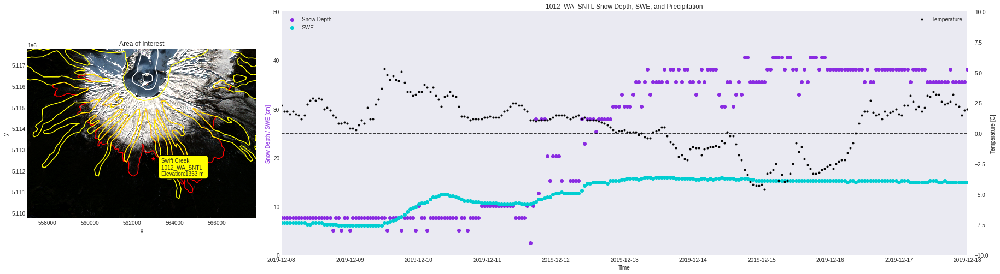

In [296]:
plot_bs_ndsi_swe_precip_with_context_H(ts_ds.rio.clip(lava_flows.geometry,lava_flows.crs,drop=True,invert=False),start_date='2019-12-08',end_date='2019-12-18')

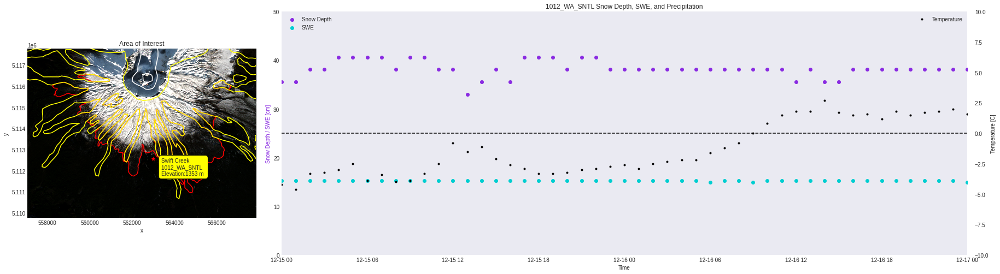

In [297]:
plot_bs_ndsi_swe_precip_with_context_H(ts_ds.rio.clip(lava_flows.geometry,lava_flows.crs,drop=True,invert=False),start_date='2019-12-15',end_date='2019-12-17')

## Let's look at the backscatter again

In [207]:
geojson = '../input/MSH_shapefiles/MSH.geojson'     
bbox_gdf = gpd.read_file(geojson)


In [208]:
ts_ds = s1_rtc_bs_utils.get_s1_rtc_stac(bbox_gdf,start_time='2019-05-01',end_time='2020-02-01',orbit_direction='all',polarization='gamma0_vv',collection=collection)
ts_ds = ts_ds.compute()
ts_ds = ts_ds.dropna('time',how='all')

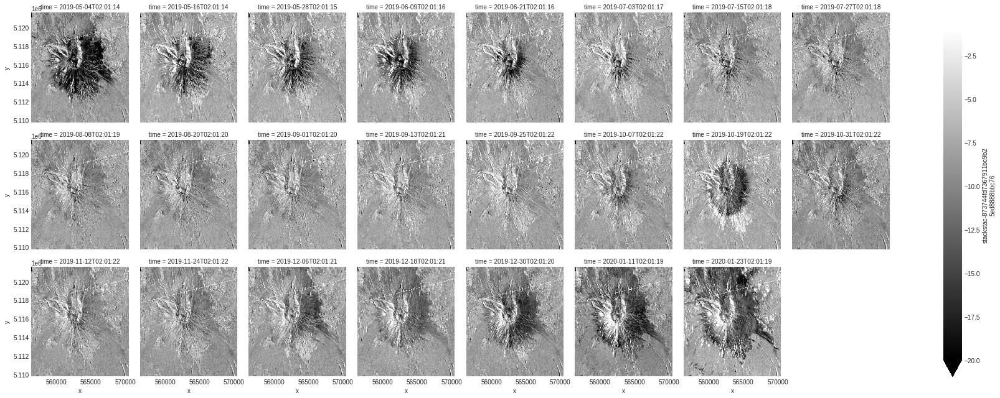

In [209]:
ts_ds_db = 10.0*np.log10(ts_ds)
ts_ds_db.plot(col='time',col_wrap=8,robust=False,cmap='gray',vmin=-20,vmax=-1)

## Septmeber 25 has the highest backscatter, let's compare to then 

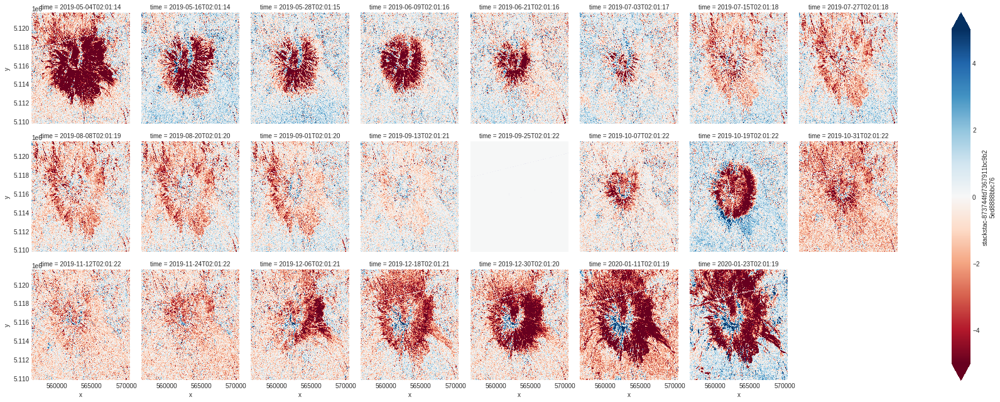

In [210]:
ts_ds_db_summer_dif = ts_ds_db-ts_ds_db.isel(time=12)
ts_ds_db_summer_dif.plot(col='time',col_wrap=8,robust=False,cmap='RdBu',vmin=-5,vmax=5)

## Now make a bianry wet snow map using -2dB drop

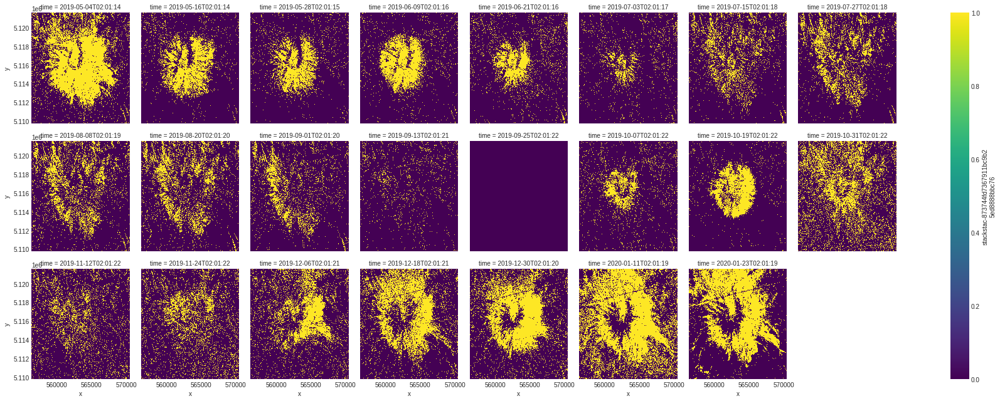

In [211]:
(ts_ds_db_summer_dif<-2).plot(col='time',col_wrap=8,robust=False)

## Now make a bianry wet snow map using -3dB drop

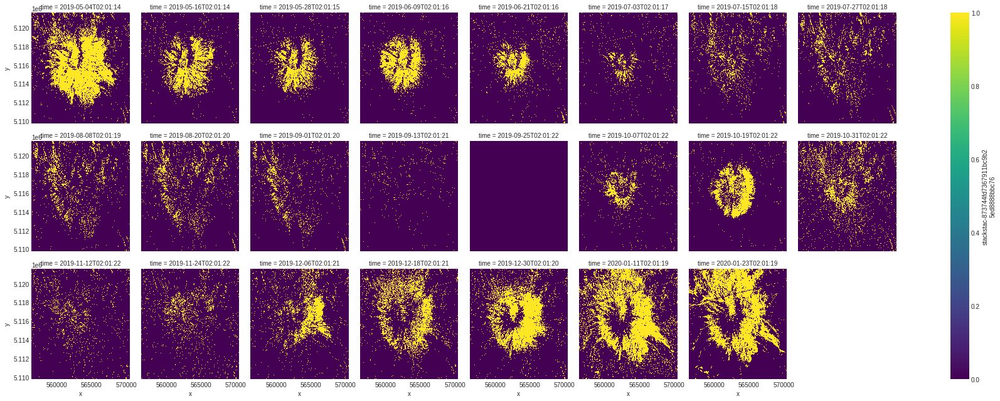

In [212]:
(ts_ds_db_summer_dif<-3).plot(col='time',col_wrap=8,robust=False)

In [262]:
#wet_snow = ts_ds_db_summer_dif.where(ts_ds_db_summer_dif<-3)
wet_snow = (ts_ds_db_summer_dif<-3).where(ts_ds_db_summer_dif<-3,np.nan)

(5109770.0, 5121590.0)

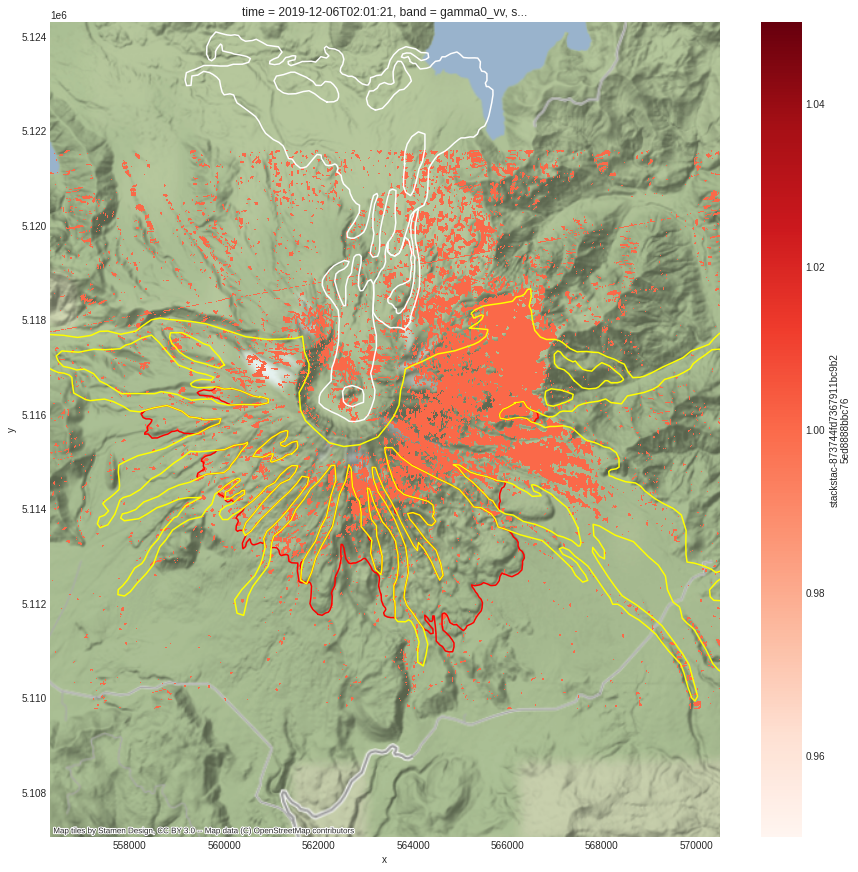

In [266]:
f,ax=plt.subplots(figsize=(15,15))

minx, miny, maxx, maxy = wet_snow.rio.bounds()
    

lava_flows.geometry.boundary.plot(ax=ax,color='red',label='Lava Flows')
lahars.geometry.boundary.plot(ax=ax,color='yellow',label='Lahars')
pyroclastic.geometry.boundary.plot(ax=ax,color='white',label='Pyroclastic Density Currents')

ctx.add_basemap(ax=ax, crs=thresh.rio.crs, source=ctx.providers.Stamen.Terrain)

wet_snow.isel(time=18).plot.imshow(ax=ax,cmap='Reds')

ax.axis('equal')

ax.set_xlim([minx,maxx])
ax.set_ylim([miny,maxy])

(5109770.0, 5121590.0)

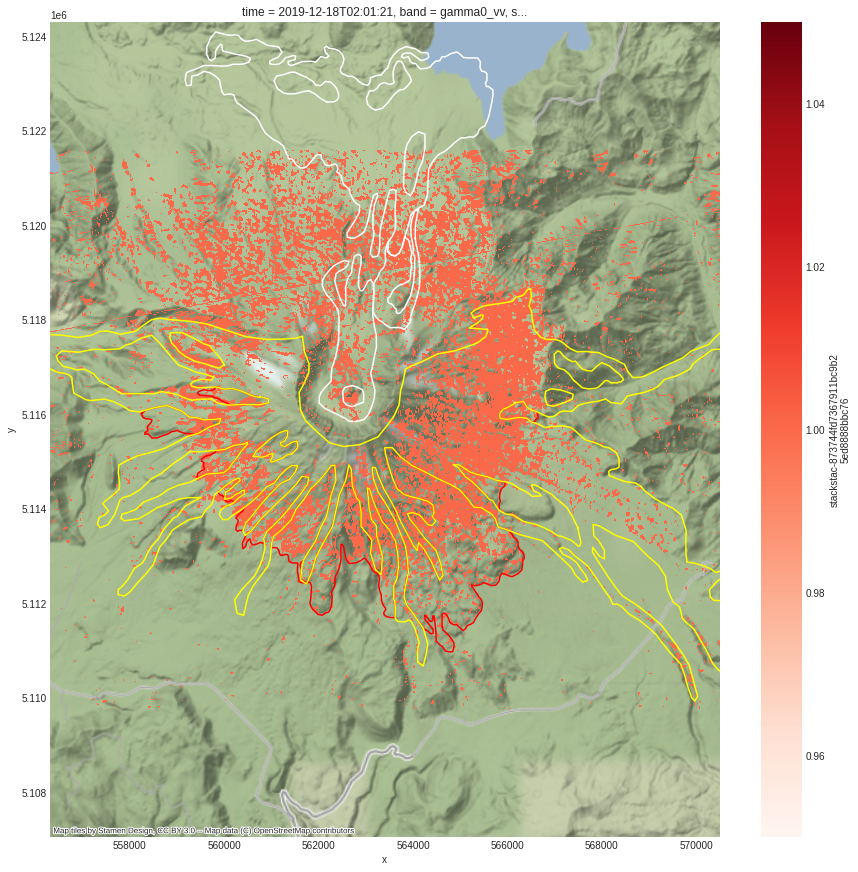

In [290]:
f,ax=plt.subplots(figsize=(15,15))

minx, miny, maxx, maxy = wet_snow.rio.bounds()
    

lava_flows.geometry.boundary.plot(ax=ax,color='red',label='Lava Flows')
lahars.geometry.boundary.plot(ax=ax,color='yellow',label='Lahars')
pyroclastic.geometry.boundary.plot(ax=ax,color='white',label='Pyroclastic Density Currents')

ctx.add_basemap(ax=ax, crs=thresh.rio.crs, source=ctx.providers.Stamen.Terrain)

wet_snow.isel(time=19).plot.imshow(ax=ax,robust=True,cmap='Reds')

ax.axis('equal')

ax.set_xlim([minx,maxx])
ax.set_ylim([miny,maxy])

## Looks like there is a December 15th scene with partial coverage of MSH but doesn't seem to be avaialble here, even when just using a bounding box of southern most portion of MSH. Manually downloading scenes using ASF S1 RTC on demand processing of Dec15 and a summertime image, and manually calculating in QGIS.

In [ ]:
# swift creek snotel: https://wcc.sc.egov.usda.gov/nwcc/view. Looks like PREC.I-1 (in) avaaible online but not through API?